In [1]:
import os
import os.path as op
import sys

import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
import pandas as pd

#from bluemath_tk.wrappers.swash.swash_wrapper import SwashModelWrapper
from IPython.display import HTML

from scripts.wrappers import SwashModelWrapper_ondas

from scripts.bathymetry import reef_profile
from scripts.plots import plot_case_config

## 01.Define Case Variables

#### Necessary Paths

In [2]:
templates_dir = '/workspaces/ONDAS_Swash/templates/templates_reef'
output_dir = '/workspaces/ONDAS_Swash/cases'

#### Hydrodynamic Forcing

In [3]:
Hs = 2.5
Tp = 10
Hs_L0 =  round((2 * np.pi * (Hs)) / (9.81 * (Tp ** 2)),4)  # Should be between 0.005 and 0.05
WL = 0.0

In [4]:
Hs_L0

0.016

#### Create Bathymetry

In [5]:
dx = 1

h0 = 15                     # offshore depth (m)
Slope1 = 0.05               # fore shore slope
Slope2 = 0.1                # inner shore slope
Wreef = 200                 # reef bed width (m)
Wfore = 500                 # flume length before fore toe (m)
bCrest = 10                 # beach heigh (m)
emsl = 2.5                  # mean sea level (m)

x_profile, depth_array = reef_profile(dx, h0, Slope1, Slope2, Wreef, Wfore, bCrest, emsl)

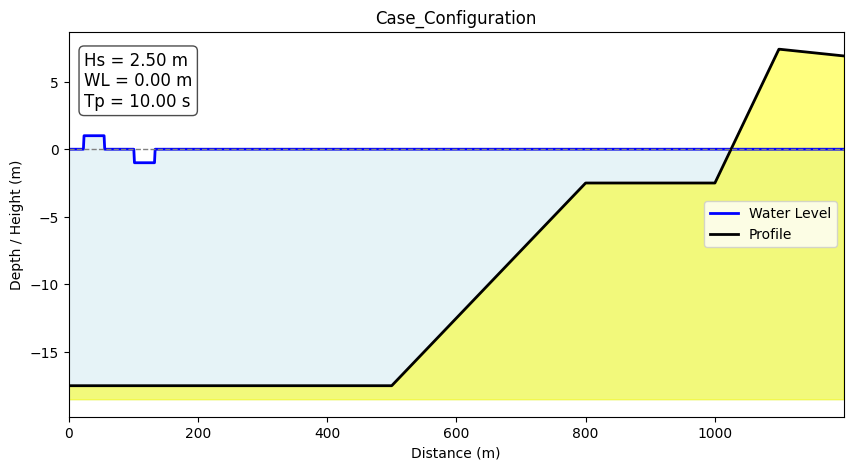

In [6]:
plot_case_config(x=x_profile, z=depth_array, wave_height=Hs, wave_period = Tp, WL=WL)

In [7]:
metamodel_parameters = pd.DataFrame({'Hs': Hs, 'Hs_L0': Hs_L0, 'WL': WL}, index=[0]).to_dict(orient='list')
fixed_parameters = {
    "dxinp": 1,  # bathymetry grid spacing  # Friction manning coefficient (m^-1/3 s)
    "comptime": 300,  # Simulation duration (s)
    "warmup": 300,  # Warmup duration (s)
    "n_nodes_per_wavelength": 60,  # number of nodes per wavelength
}

swash_model = SwashModelWrapper_ondas(
    templates_dir=templates_dir,
    metamodel_parameters=metamodel_parameters,
    fixed_parameters=fixed_parameters,
    output_dir=output_dir,
    depth_array=-depth_array,
)

In [8]:
swash_model.build_cases(cases_name_format=lambda ctx: 'reef')

In [ ]:
swash_model.run_cases(launcher='serial')

In [ ]:
vars_to_postprocess = ["Msetup", "Hrms", "Hfreqs"]
postprocessed = swash_model.postprocess_cases(output_vars=vars_to_postprocess).isel(case_num=0)

In [ ]:
postprocessed

<xarray.Dataset> Size: 67kB
Dimensions:   (Xp: 1200)
Coordinates:
  * Xp        (Xp) int64 10kB 0 1 2 3 4 5 6 ... 1194 1195 1196 1197 1198 1199
    Yp        int64 8B 0
    case_num  int64 8B 0
Data variables:
    Msetup    (Xp) float64 10kB 0.01833 0.01587 0.01298 ... 6.915 6.91 6.906
    Hrms      (Xp) float64 10kB 1.769 1.756 1.735 ... 2.512e-15 2.512e-15
    Hs        (Xp) float64 10kB 2.542 2.523 2.493 ... 3.243e-15 0.0 3.243e-15
    Hss       (Xp) float64 10kB 2.528 2.508 2.477 ... 1.176e-18 0.0 1.176e-18
    ig        (Xp) float64 10kB 0.2711 0.2714 0.2776 ... 3.243e-15 0.0 3.243e-15
    Hvlf      (Xp) float64 10kB 0.07267 0.07261 0.07451 ... 0.0 3.036e-15

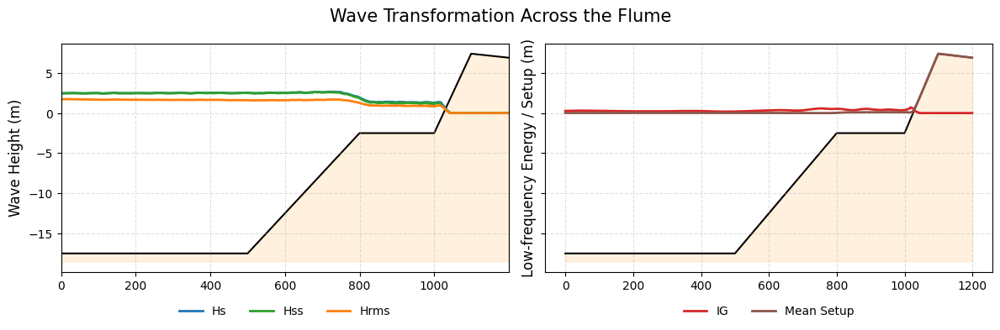

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

fig, axs = plt.subplots(1, 2, figsize=(12,4), sharey=True)

ax1 = axs[0]
ax1.plot(postprocessed.Xp, postprocessed.Hs, label='Hs', color='tab:blue', lw=2)
ax1.plot(postprocessed.Xp, postprocessed.Hss, label='Hss', color='tab:green', lw=2)
ax1.plot(postprocessed.Xp, postprocessed.Hrms, label='Hrms', color='tab:orange', lw=2)

ax1.fill_between(np.arange(0, len(depth_array)), depth_array, np.min(depth_array)-1,
                 color='navajowhite', alpha=0.4, zorder=0)
ax1.plot(np.arange(0, len(depth_array)), depth_array, color='k', lw=1.5, zorder=1)

ax1.set_ylabel('Wave Height (m)', fontsize=12)
ax1.grid(True, ls='--', alpha=0.4)
ax1.legend(loc='upper right', fontsize=10, ncol=2, frameon=True)

ax2 = axs[1]
ax2.plot(postprocessed.Xp, postprocessed.ig, label='IG', color='tab:red', lw=2)
ax2.plot(postprocessed.Xp, postprocessed.Msetup, label='Mean Setup', color='tab:brown', lw=2)

ax2.fill_between(np.arange(0, len(depth_array)), depth_array, np.min(depth_array)-1,
                 color='navajowhite', alpha=0.4, zorder=0)
ax2.plot(np.arange(0, len(depth_array)), depth_array, color='k', lw=1.5, zorder=1)

ax2.set_ylabel('Low-frequency Energy / Setup (m)', fontsize=12)
ax2.grid(True, ls='--', alpha=0.4)
ax2.legend(loc='upper right', fontsize=10, ncol=2, frameon=True)

axs[0].set_xlim([np.min(postprocessed.Xp), np.max(postprocessed.Xp)])

ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1),
           ncol=3, fontsize=10, frameon=False)
ax2.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1),
           ncol=2, fontsize=10, frameon=False)

fig.suptitle('Wave Transformation Across the Flume', fontsize=15)

plt.tight_layout()
plt.show()


In [ ]:
output_data = xr.open_dataset('/workspaces/ONDAS_Swash/cases/reef/output.nc')

In [ ]:
import matplotlib.animation as animation


watlev = output_data["Watlev"]  # shape: (Xp, Yp, Tsec)
x = output_data["Xp"]
time = output_data["Tsec"]

watlev_1d = watlev.isel(Yp=0)

fig, ax = plt.subplots()
line, = ax.plot(x, watlev_1d.isel(Tsec=0), lw=2)

ax.fill_between(np.arange(0, len(depth_array)), depth_array, np.min(depth_array)-1,
                 color='navajowhite', alpha=0.4, zorder=0)
ax.plot(np.arange(0, len(depth_array)), depth_array, color='k', lw=1.5, zorder=1)


ax.set_xlim(x.min(), x.max())
ax.set_xlabel("X position")
ax.set_ylabel("Water Level (Watlev)")
title = ax.set_title("Time = 0 s")

# Animation function
def update(frame):
    line.set_ydata(watlev_1d.isel(Tsec=frame))
    title.set_text(f"Time = {time[frame].item()} s")
    return line, title

# Create the animation
ani = animation.FuncAnimation(
    fig, update, frames=len(time), interval=100, blit=True
)

plt.close()

HTML(ani.to_jshtml())

INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.HTMLWriter'>


In [ ]:
pip install seaborn #### Esto instala la liberia, solo hay que ejecutarlo una vez

Note: you may need to restart the kernel to use updated packages.


<Axes: >

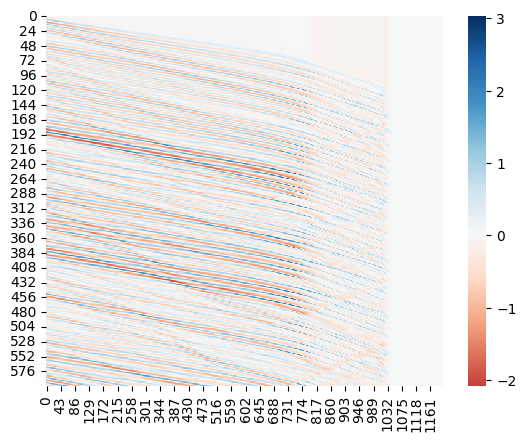

In [ ]:
import seaborn as sns

data = watlev_1d.values.T
row_mean = np.mean(data, axis=0, keepdims=True)

sns.heatmap(data - row_mean, cmap='RdBu', center=0)